## Diffusion Showcase with Stable Diffusion

In [3]:
#only for Google Colab
#for problems with package versions look in the requirements-colab-freeze.txt and requirements-pip-freeze.txt files
!pip install diffusers
!pip install jupyter_bbox_widget
!git clone https://github.com/phonosync/demo_diffusion
!mv demo_diffusion/* ./
from google.colab import output
output.enable_custom_widget_manager()

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 19.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 367.8/367.8 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 9.2 MB/s eta 0:00:00
Cloning into 'demo_diffusion'...
remote: Enumerating objects: 37, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (9/9), done.
remote: Total 37 (delta 3), reused 0 (delta 0), pack-reused 28
Receiving objects: 100% (37/37), 41.23 MiB | 18.46 MiB/s, done.
Resolving deltas: 100% (9/9), done.


In [4]:
from PIL import Image, ImageDraw
from utils.diffusion_utils import randomImage, text2image, text2image_latent_walk_image, text2image_latent_walk_prompt, image2image, inpaint, text2image_prompt_merging, text2image_prompt_interpolation, plot_two_images, encode_image
from IPython.display import Image as DisplayImage
from jupyter_bbox_widget import BBoxWidget
from ipywidgets import Layout

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.


running on cpu


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/543 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/346 [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/807 [00:00<?, ?B/s]

(…)ature_extractor/preprocessor_config.json:   0%|          | 0.00/342 [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/911 [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/553 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/613 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.36G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/3.46G [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

### Random Image

  0%|          | 0/20 [00:00<?, ?it/s]

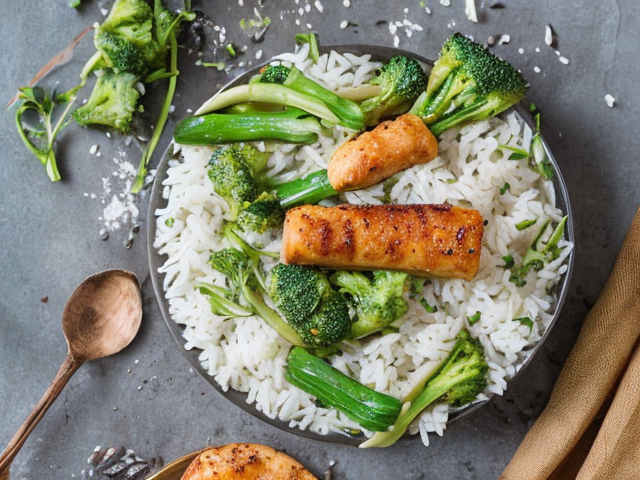

In [3]:
randomImage(num_inference_steps=20)

### Text to Image

_Try with or without "a photo of"_

  0%|          | 0/20 [00:00<?, ?it/s]

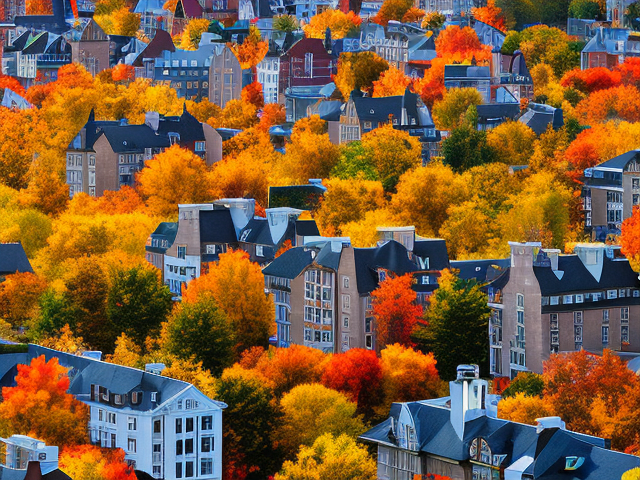

In [4]:
generated_image, gif_path = text2image("a photo of an autumn cityscape", num_inference_steps=20, seed=3, create_gif=True)
generated_image

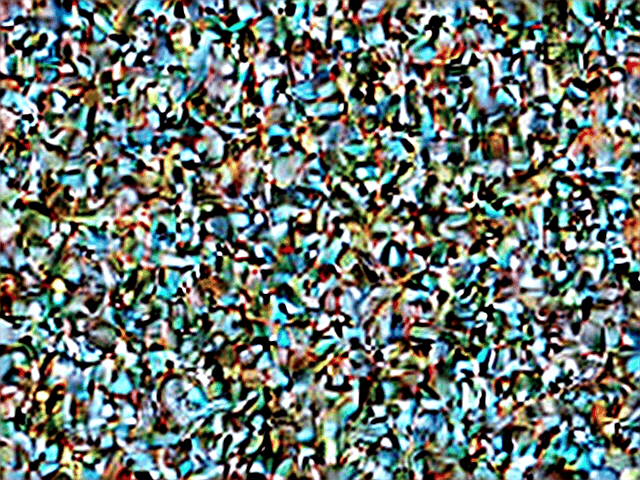

In [5]:
DisplayImage(filename=gif_path)

### Prompt changed a little

  0%|          | 0/20 [00:00<?, ?it/s]

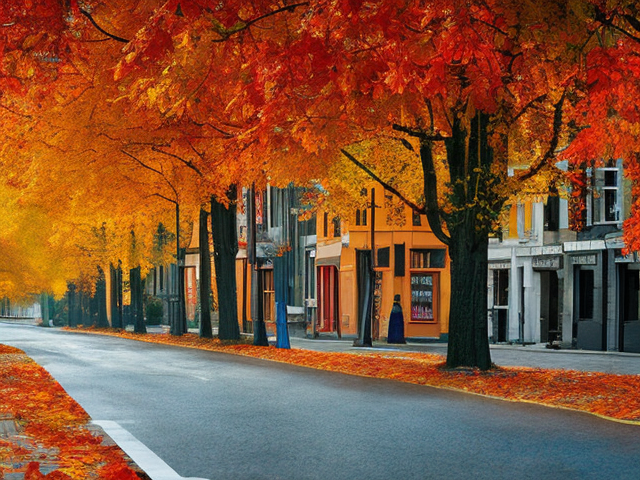

In [6]:
text2image("a photo of an autumn city", num_inference_steps=20, seed=3)

### Same prompt different noise

  0%|          | 0/20 [00:00<?, ?it/s]

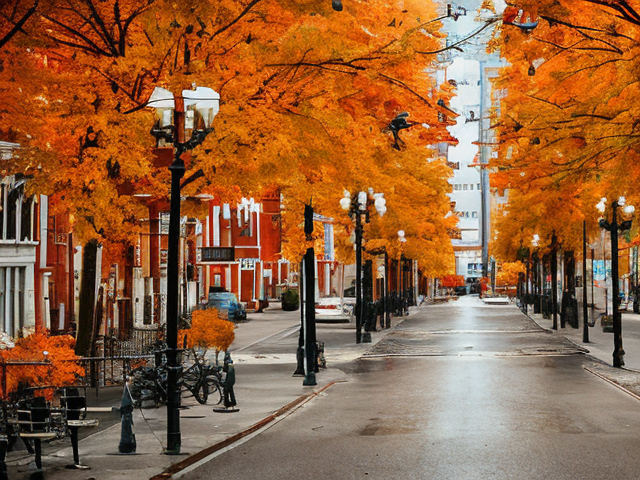

In [7]:
text2image("a photo of an autumn city", num_inference_steps=20, seed=4)

### Inpainting

_Click and drag to draw rectangles that will be used as masks for inpainting._

In [8]:
widget = BBoxWidget(
    image=encode_image(generated_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='40%')
)
widget

BBoxWidget(colors=['#ff0000'], hide_buttons=True, image='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAoAAAAH…

  0%|          | 0/20 [00:00<?, ?it/s]

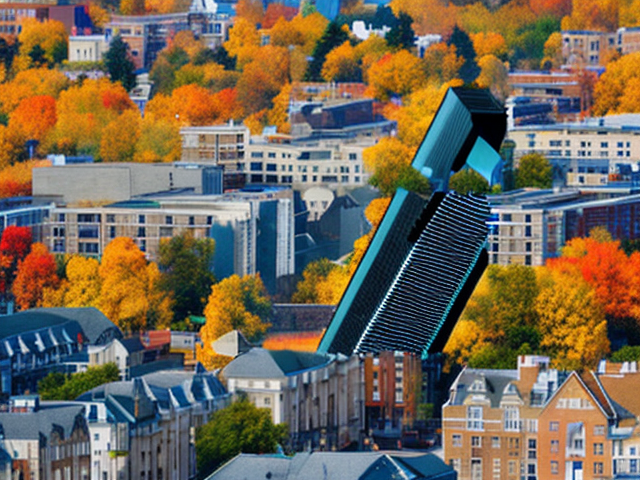

In [ ]:
mask = Image.new('L', generated_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

inpaint(prompt="skyscraper",
        init_image=generated_image,
        mask_image=mask,
        num_inference_steps=20)

### Image to Image

  0%|          | 0/12 [00:00<?, ?it/s]

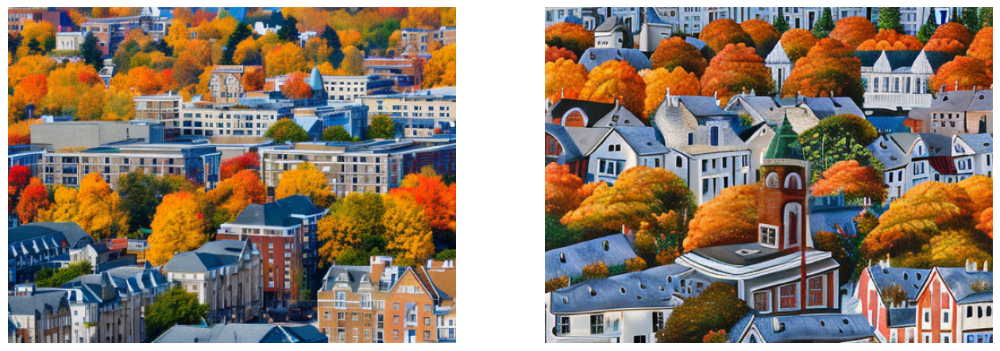

In [ ]:
new_image = image2image(prompt="a photo of an autumn city with a boat", image=generated_image, strength=0.6)
plot_two_images(generated_image, new_image)


### Drawing to Image

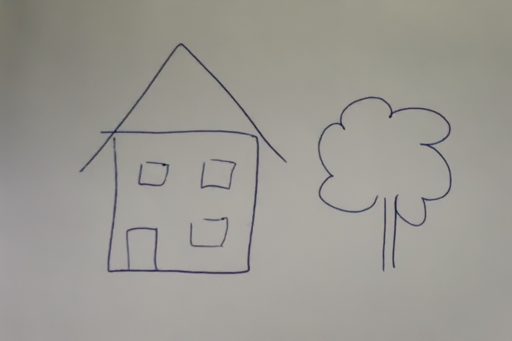

In [ ]:
sketch = Image.open("utils/sketch.jpg")
sketch.thumbnail((512,512))
sketch

  0%|          | 0/30 [00:00<?, ?it/s]

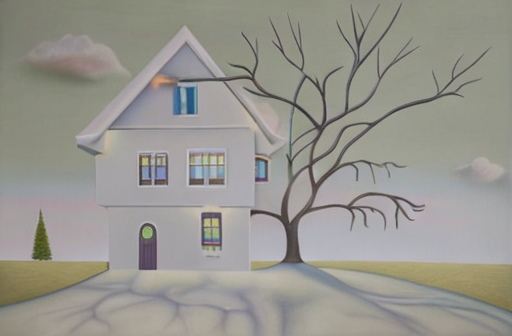

In [ ]:
image2image(prompt="a colorful photorealistic image of a house with a tree", image_path="utils/sketch.jpg", strength=0.6, num_inference_steps=50)

# Inpainting Examples from Lecture

### Flag Inpainting

In [7]:
# This is the actual example generated for the slides:
fp_starting_image = 'utils/inpainting-samples/flagge.jpg'

starting_image = Image.open(fp_starting_image)

# Bounding box selected for flag example:
bbox = {'x': 798, 'y': 611, 'width': 492, 'height': 441}

# created the masked image from a copy of the starting image
masked_image = starting_image.copy()
# apply the mask defined by the bounding box
draw = ImageDraw.Draw(masked_image)
draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=(255,255,255), outline='black')

# Note that the
masked_image.show()

  0%|          | 0/15 [00:00<?, ?it/s]

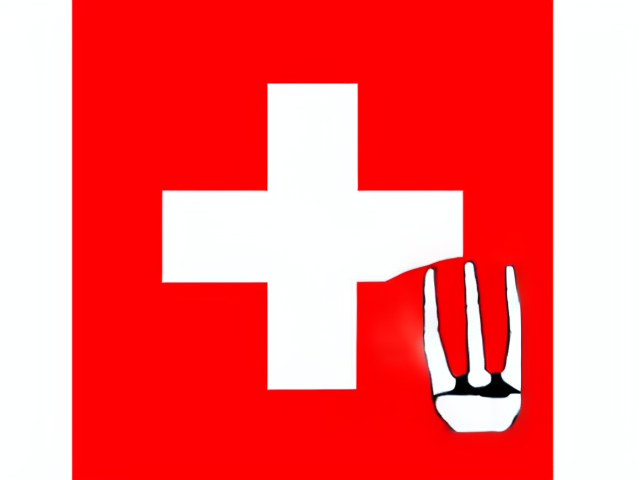

In [6]:
# The Stable diffusion inpainting pipeline requires a mask according to:
# White pixels in the mask are repainted while black pixels are preserved.
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

#less steps seem to work better, for this simple image
inpaint(prompt="red and white only",
        init_image=starting_image,
        mask_image=mask,
        num_inference_steps=15,
        seed=1)

### House Inpainting

In [34]:
file_path = 'utils/inpainting-samples/haus.jpg'
starting_image = Image.open(file_path)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='33%'),
    bboxes=[{'x': 94, 'y': 59, 'width': 55, 'height': 40, 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 94, 'y': 59, 'width': 55, 'height': 40, 'label': 'mask'}], colors=['#ff0000'], hide_b…

  0%|          | 0/30 [00:00<?, ?it/s]

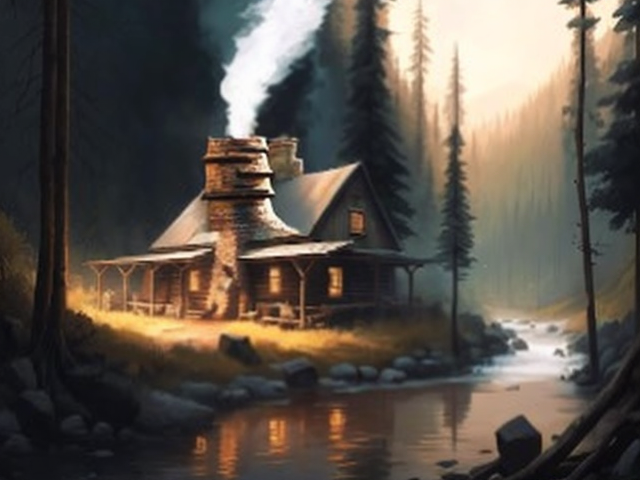

In [35]:
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

inpaint(prompt="chimney of a cottage",
        init_image=starting_image,
        mask_image=mask,
        num_inference_steps=30,
        seed=25)

### Landscape Inpainting

In [ ]:
file_path = 'utils/inpainting-samples/landschaft.jpg'
starting_image = Image.open(file_path)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='33%'),
    bboxes=[{'x': 44, 'y': 34, 'width': 181, 'height': 123, 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 44, 'y': 34, 'width': 181, 'height': 123, 'label': 'mask'}], classes=['mask'], colors…

  0%|          | 0/20 [00:00<?, ?it/s]

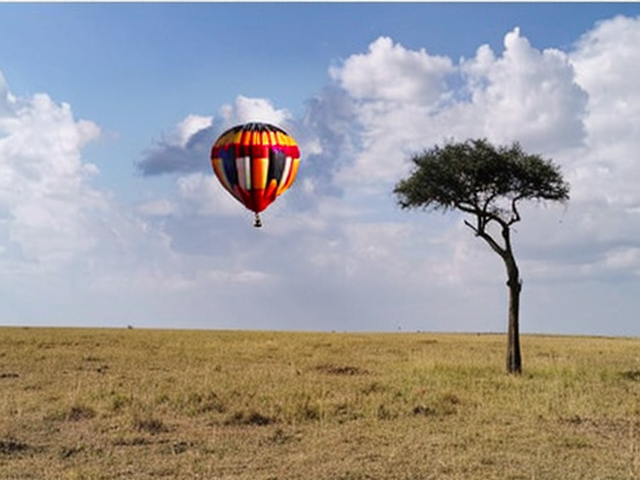

In [ ]:
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

# "fully visible" seems to help with inpainting
inpaint(prompt="hot air balloon, fully visible",
        init_image=starting_image,
        mask_image=mask,
        num_inference_steps=20,
        seed=3)

### TV Inpainting

In [ ]:
file_path = 'utils/inpainting-samples/tv.jpg'
starting_image = Image.open(file_path)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#ff0000'],
    hide_buttons=True,
    layout=Layout(width='33%'),
    bboxes=[{'x': 168, 'y': 42, 'width': 262, 'height': 152, 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 168, 'y': 42, 'width': 262, 'height': 152, 'label': 'mask'}], classes=['mask'], color…

  0%|          | 0/50 [00:00<?, ?it/s]

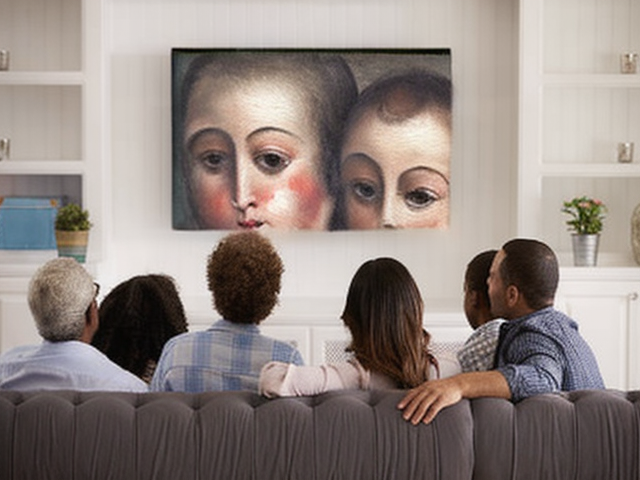

In [ ]:
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)
for bbox in widget.bboxes:
    draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']], fill=255)

inpaint(prompt="old oil painting",
       init_image=starting_image,
       mask_image=mask,
       num_inference_steps=50,
       seed=3)

# inpaint(prompt="tv image of a soccer match",
#         init_image=starting_image,
#         mask_image=mask,
#         num_inference_steps=50,
#         seed=3)

## Selecting Bounding Boxes and Creating a Mask for Inpainting

In [71]:
# This code was used to generate the masked images:

fp_image = 'utils/inpainting-samples/flagge.jpg'
starting_image = Image.open(fp_image)

widget = BBoxWidget(
    image=encode_image(starting_image),
    colors=['#008000'], # color of the outline of the mask
    hide_buttons=True,
    layout=Layout(width='33%'),
    # this are just the initial values for starting the widget
    bboxes=[{'x': int(starting_image.size[0]*0.5),
             'y': int(starting_image.size[1]*0.5),
             'width': int(starting_image.size[0]*0.2),
             'height': int(starting_image.size[1]*0.2), 'label': 'mask'}]
)
widget

BBoxWidget(bboxes=[{'x': 800, 'y': 590, 'width': 320, 'height': 236, 'label': 'mask'}], colors=['#008000'], hi…

In [75]:
# Retrieve the updated coordinates of the bounding box
bbox = widget.bboxes[0]

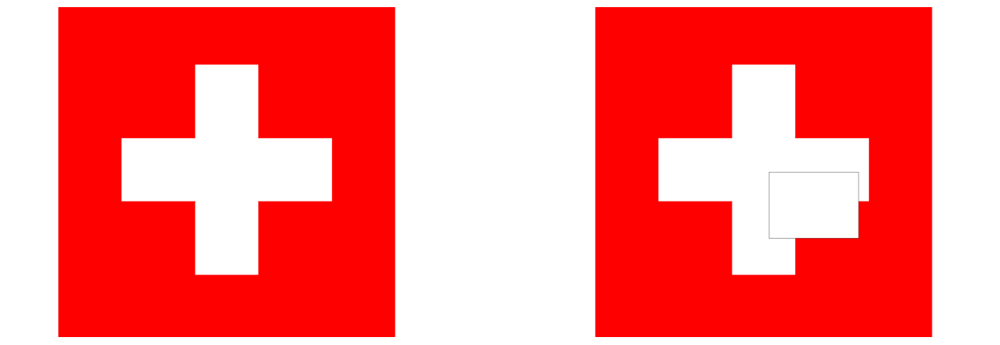

In [76]:
# Create a second instance of the image to mask out the selected bounding box
# for illustration purposes
masked_image = Image.open(fp_image)
draw = ImageDraw.Draw(masked_image)


draw.rectangle([bbox['x'], bbox['y'], bbox['x']+bbox['width'], bbox['y']+bbox['height']],
               fill=(255,255,255), outline='black')

# note that the black outline of the mask is just shown for illustration purposes
plot_two_images(starting_image, masked_image)

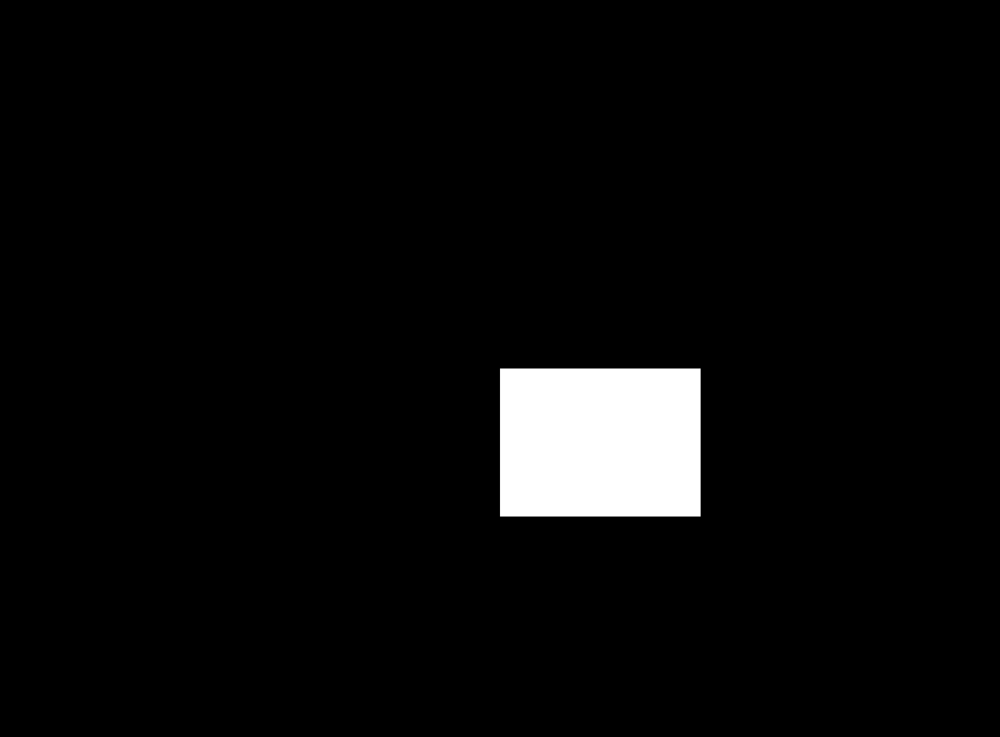

In [77]:
# The Stable diffusion inpainting pipeline requires a mask according to:
# White pixels in the mask are repainted while black pixels are preserved.
mask = Image.new('L', starting_image.size, 0)
draw = ImageDraw.Draw(mask)

draw.rectangle([bbox['x'], bbox['y'],
                bbox['x'] + bbox['width'],
                bbox['y'] + bbox['height']],
               fill=255)

mask

# Additional Material

### Stable Diffusion Prompt Merging

  0%|          | 0/20 [00:00<?, ?it/s]

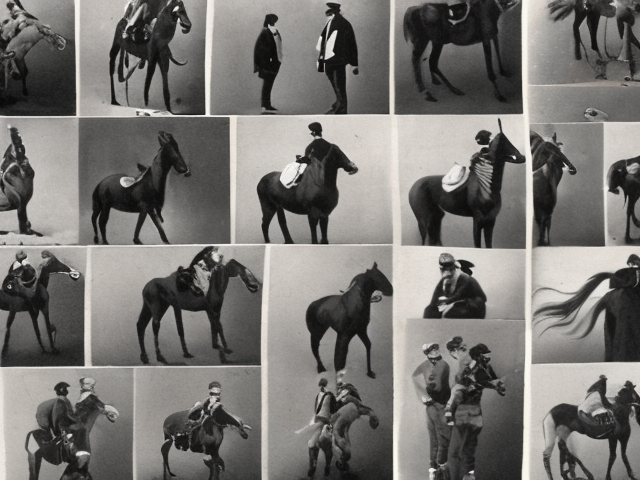

In [ ]:
text2image_prompt_merging(prompt1="horse", prompt2="human", mix_factor=0.4, num_inference_steps=20)

### Stable Diffusion Prompt Interpolation

In [ ]:
generated_image, gif_path = text2image_prompt_interpolation(prompt1="An octopus", prompt2="An elephant", num_interpolation_steps=30, num_inference_steps=10)
DisplayImage(filename=gif_path)

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

  0%|          | 0/10 [00:00<?, ?it/s]

TypeError: 'module' object is not callable

### Walking through latent space

  0%|          | 0/35 [00:00<?, ?it/s]

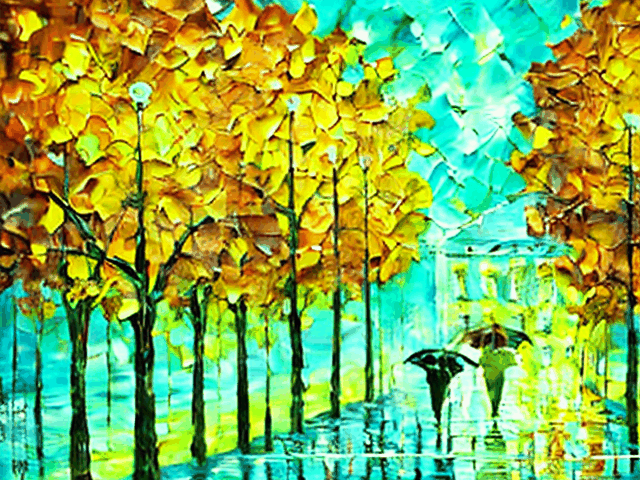

In [ ]:
generated_image, gif_path = text2image_latent_walk_image("Palette knife painting of an autumn cityscape", num_inference_steps=35)
DisplayImage(filename=gif_path)

### Walking through prompt space

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

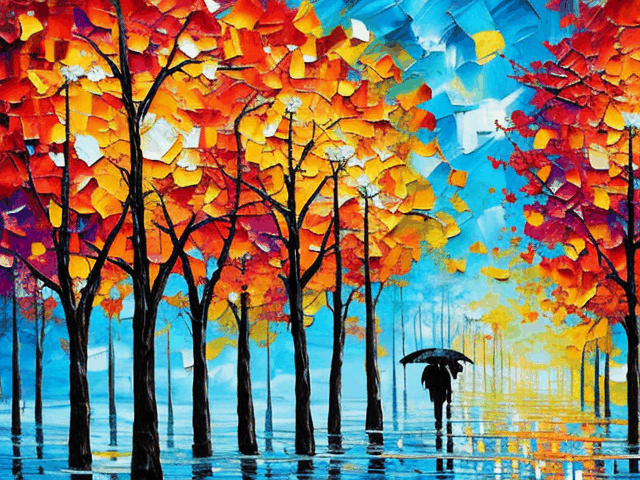

In [ ]:
generated_image, gif_path = text2image_latent_walk_prompt("Palette knife painting of an autumn cityscape")
DisplayImage(filename=gif_path)